### Device to CUDA or MPS

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.image import imsave
from latex import latexify, format_axes
try:
    from einops import rearrange
except ImportError:
    %pip install einops
    from einops import rearrange
    
from sklearn import preprocessing
import warnings
warnings.filterwarnings("ignore")

%matplotlib inline
%config InlineBackend.figure_format = "retina"

if torch.backends.mps.is_available():
    device = torch.device("mps")
elif torch.cuda.is_available():
    device = torch.device("cuda")
else:
    device = torch.device("cpu")
    
print(device)

cuda


### The Image $(1365 \times 2048)$

![dog](./dog.jpg)

In [2]:
img = torchvision.io.read_image("dog.jpg")
print(img.shape)

torch.Size([3, 1365, 2048])


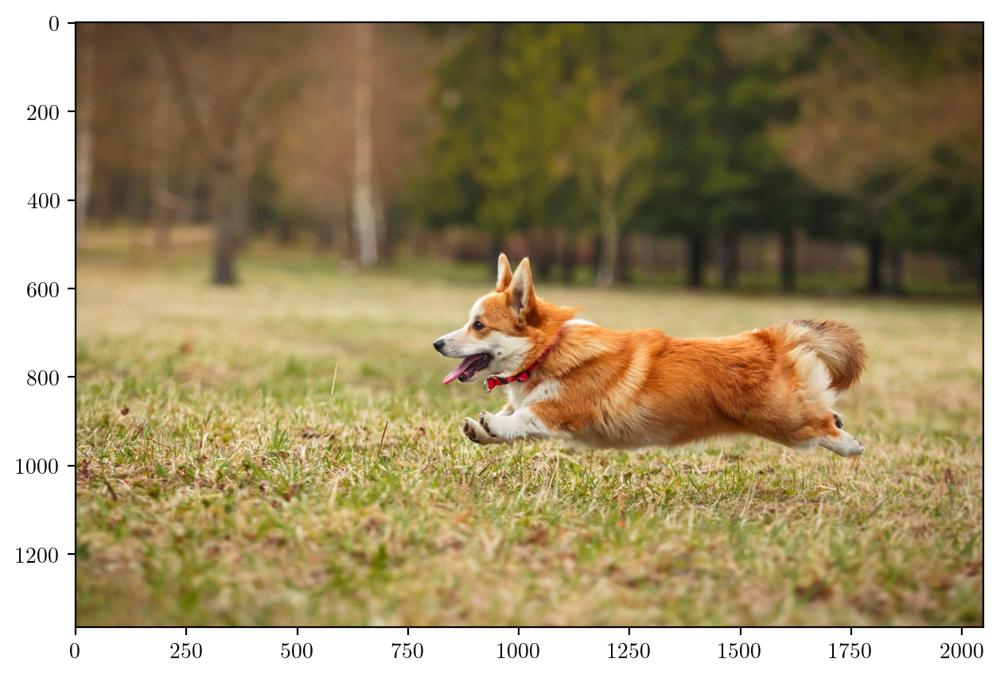

In [3]:
latexify(columns = 2, fig_width = 8)
plt.imshow(rearrange(img, "c h w -> h w c").numpy())
plt.show()

In [4]:
img = torchvision.transforms.functional.crop(img.cpu(), 550, 750, 400, 400)
print(img.shape)

torch.Size([3, 400, 400])


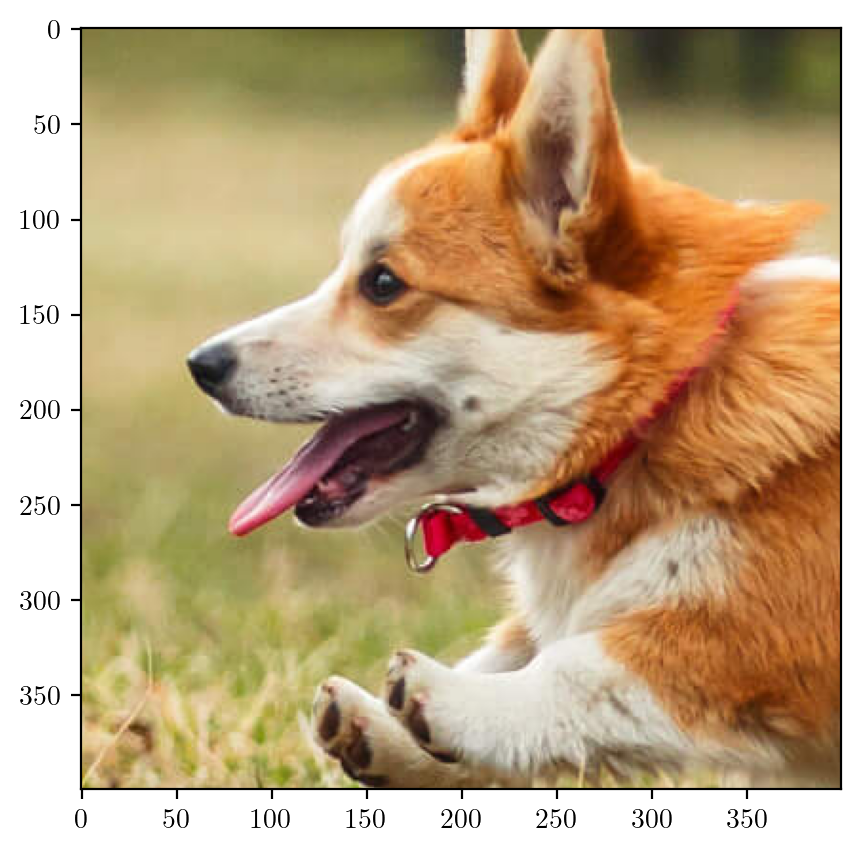

In [5]:
latexify(columns = 2, fig_width = 8)
plt.imshow(rearrange(img, "c h w -> h w c").numpy())
plt.show()

In [6]:
scaler_img = preprocessing.MinMaxScaler().fit(img.reshape(-1, 1))
img_scaled = scaler_img.transform(img.reshape(-1, 1)).reshape(img.shape)
img_scaled.shape
img_scaled = torch.tensor(img_scaled)
img_scaled = img_scaled.to(device, dtype = torch.float32)
img_scaled

tensor([[[0.4902, 0.4902, 0.5216,  ..., 0.3333, 0.3451, 0.3490],
         [0.4902, 0.4902, 0.5216,  ..., 0.3373, 0.3490, 0.3529],
         [0.5020, 0.5020, 0.5137,  ..., 0.3569, 0.3569, 0.3569],
         ...,
         [0.8667, 0.8118, 0.6039,  ..., 0.4745, 0.4667, 0.4549],
         [0.8275, 0.6588, 0.5647,  ..., 0.4980, 0.4863, 0.4745],
         [0.7294, 0.5569, 0.5725,  ..., 0.5216, 0.5098, 0.4941]],

        [[0.4824, 0.4824, 0.4863,  ..., 0.2980, 0.3098, 0.3137],
         [0.4824, 0.4824, 0.4863,  ..., 0.3020, 0.3137, 0.3176],
         [0.4784, 0.4784, 0.4784,  ..., 0.3255, 0.3255, 0.3255],
         ...,
         [0.7843, 0.7373, 0.5804,  ..., 0.3804, 0.3725, 0.3608],
         [0.7529, 0.5961, 0.5451,  ..., 0.4039, 0.3922, 0.3804],
         [0.6784, 0.5098, 0.5569,  ..., 0.4275, 0.4157, 0.4000]],

        [[0.2510, 0.2510, 0.2549,  ..., 0.1765, 0.1882, 0.1922],
         [0.2510, 0.2510, 0.2549,  ..., 0.1725, 0.1843, 0.1882],
         [0.2431, 0.2431, 0.2471,  ..., 0.1804, 0.1804, 0.

### Function to extract patch $(d \times d)$ from TopLeft corner $(X, Y)$ containing $N$ different colors

In [7]:
def mask_image(img, Corner, d, verbose, display = True):
    X, Y = Corner
    latexify(columns = 2, fig_width = 10)
    img_copy = img.clone()
    img_copy[:, X : X + d, Y : Y + d] = float("nan")
    crop = torchvision.transforms.functional.crop(img.cpu(), X, Y, d, d)
    fig, ax = plt.subplots(nrows = 1, ncols = 2, gridspec_kw = {"width_ratios": [img.shape[2] / (5 * d), 1]})
    fig.suptitle(fr"{verbose} with corner at $({Corner[0]}, {Corner[1]})$ and patch size = $({d} \times {d})$", fontsize = 16)
    ax[0].imshow(rearrange(img_copy, 'c h w -> h w c').cpu().numpy())
    ax[0].set_title("Masked Image")
    ax[1].imshow(rearrange(crop, 'c h w -> h w c').cpu().numpy())
    ax[1].set_title("Masked Crop")
    if (display):
        plt.show()
    else:
        plt.close()
    return img_copy, crop

## Gradient Descent using Adam Optimizer $A_{N \times M} \approx W_{N \times k} H_{k \times M}$

In [8]:
def factorize(Img, k, convergence, device = torch.device("cpu")):
    """Factorize the matrix D into A and B"""
    Img = Img.to(device)
    Ws, Hs, losses, images = [], [], [], []
    for channel in range(Img.shape[0]):
        A = Img[channel]
        
        torch.manual_seed(42)
        W = torch.randn(A.shape[0], k, requires_grad = True, device = device)
        H = torch.randn(k, A.shape[1], requires_grad = True, device = device)

        optimizer = optim.Adam([W, H], lr = 0.02)
        mask = ~torch.isnan(A)
        prev_loss = float('inf')
        for i in range(10000):

            diff_matrix = torch.mm(W, H) - A
            diff_vector = diff_matrix[mask]
            loss = torch.norm(diff_vector)
            
            if torch.abs(prev_loss - loss) < convergence:
                break
            
            optimizer.zero_grad()
            
            loss.backward()

            optimizer.step()
            
            prev_loss = loss.item()
            
        Ws.append(W)
        Hs.append(H)
        losses.append(loss)
        images.append(torch.mm(W, H))
    
    return Ws, Hs, losses, torch.stack([images[0], images[1], images[2]], dim = 0), i

#### $$ \text{PSNR} = 20 \log_{10}(\frac{\text{MAX}_I}{\sqrt{\text{MSE}}})$$

In [9]:
def metrics(img1, img2, max_value = 1.0):
    rmse = torch.sqrt(F.mse_loss(img1, img2))
    psnr_value = 20 * torch.log10(max_value / rmse)
    return rmse, psnr_value.item()

## Function for Training and Plotting the Reconstructed Image

In [10]:
def train_reconstruct_plot(img, Corner, d, features, convergence, device, allowSave = False, FileName = None, allowMetrics = False):
    imgSingle, croppedSingle = mask_image(img, Corner, d, "Single Colored Patch", display = False)
    Ws, Hs, losses, FinalImage, i = factorize(imgSingle, features, convergence, device)
    img_copy = FinalImage.clone()
    X, Y = Corner
    newCroppedSingle = img_copy[:, X : X + d, Y : Y + d]
    rmse, psnr = metrics(img, img_copy)
    latexify(columns = 2)
    fig, ax = plt.subplots(nrows = 1, ncols = 3, gridspec_kw = {"width_ratios": [img.shape[2] / (3 * d), 1, img.shape[2] / (3 * d)]}, figsize = (15, 8))
    fig.suptitle(f"RMSE : {rmse} | PNSR : {psnr}" "\n" fr"Crop Corner = $({X}, {Y})$" "\n" f"Features = {features}" "\n" fr"Loss Red = {losses[0]}, Loss Green = {losses[0]}, Loss Blue = {losses[2]}" "\n" f"Converged after {i} iteration", fontsize = 12)
    ax[0].imshow(rearrange(imgSingle, 'c h w -> h w c').cpu().numpy())
    ax[0].set_title("Masked Image" "\n" rf"$({img.shape[1]} \times {img.shape[2]})$")
    ax[1].imshow(rearrange(croppedSingle, 'c h w -> h w c').cpu().numpy())
    ax[1].set_title("Patch" "\n" fr"$({d} \times {d})$")
    ax[2].imshow(rearrange(FinalImage, 'c h w -> h w c').cpu().detach().numpy())
    ax[2].set_title("Reconstructed Image" "\n" rf"$({img.shape[1]} \times {img.shape[2]})$")
    if (allowSave):
        # FinalImage = F.normalize(FinalImage, 0, 1)
        FinalImage = (FinalImage - FinalImage.min()) / (FinalImage.max() - FinalImage.min())
        FinalImage = torch.clamp(FinalImage, 0, 1)
        imsave(f"{FileName}.png", rearrange(FinalImage, 'c h w -> h w c').cpu().detach().numpy())
    for i in range(3):
        ax[i].axis("off")
    plt.show()
    
    fig, ax = plt.subplots(nrows = 1, ncols = 2, gridspec_kw = {"width_ratios": [1, 1]}, figsize = (8, 4))
    fig.suptitle("Comparison of Original and Reconstructed Patch", fontsize = 12)                                                  
    ax[0].imshow(rearrange(croppedSingle, 'c h w -> h w c').cpu().numpy())
    ax[0].set_title("Original Patch")
    ax[0].axis("off")
    ax[1].imshow(rearrange(newCroppedSingle, 'c h w -> h w c').cpu().detach().numpy())
    ax[1].set_title("Reconstructed Patch")
    ax[1].axis("off")
    plt.show()
    
    if (allowMetrics):
        return rmse, psnr

### $(30 \times 30)$ frame with **Single Color**

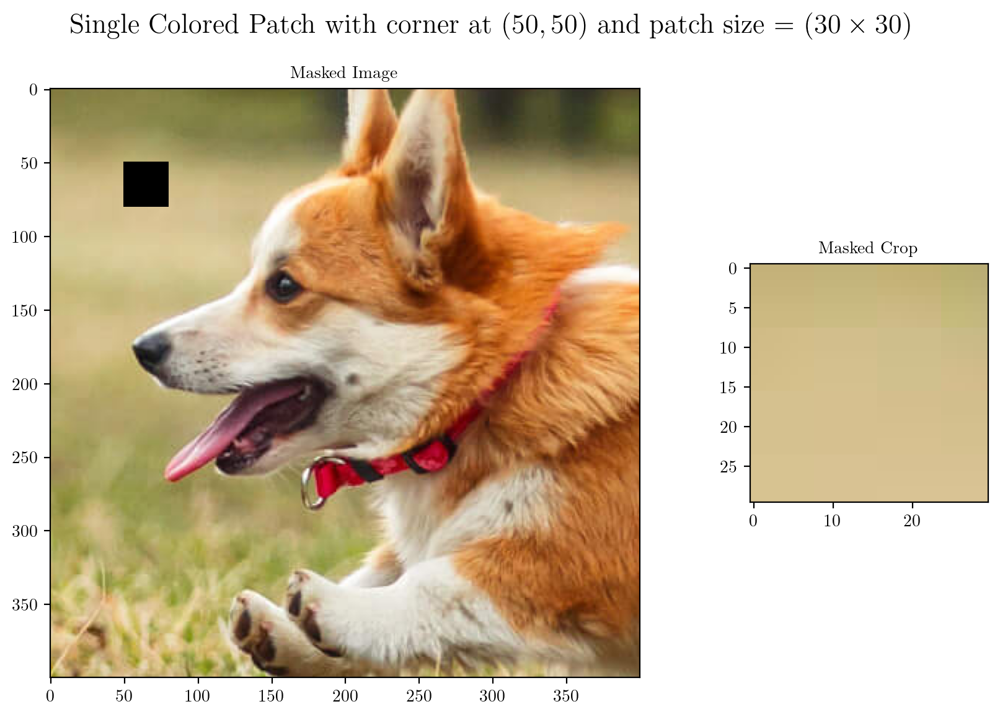

In [11]:
imgSingle30, croppedSingle30 = mask_image(img_scaled, (50, 50), 30, "Single Colored Patch")

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


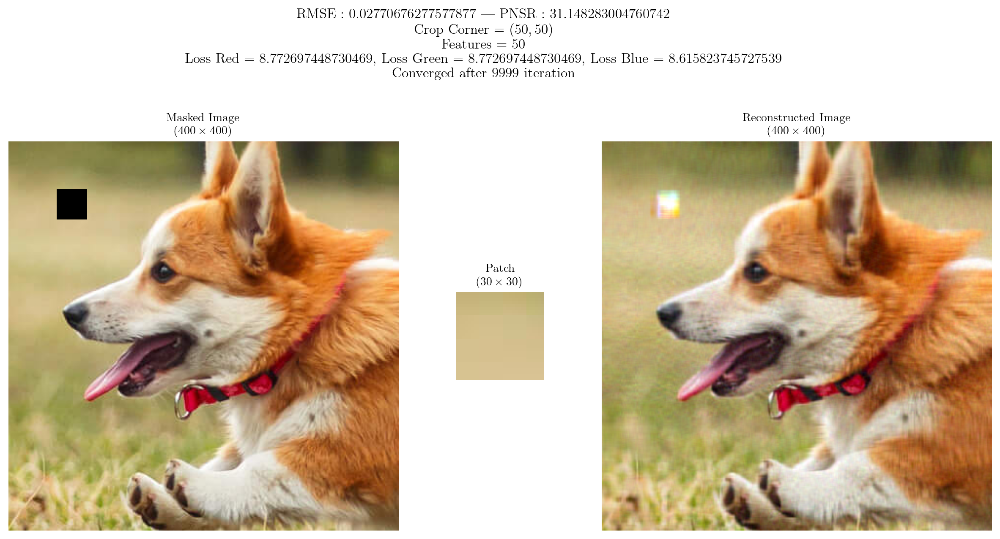

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


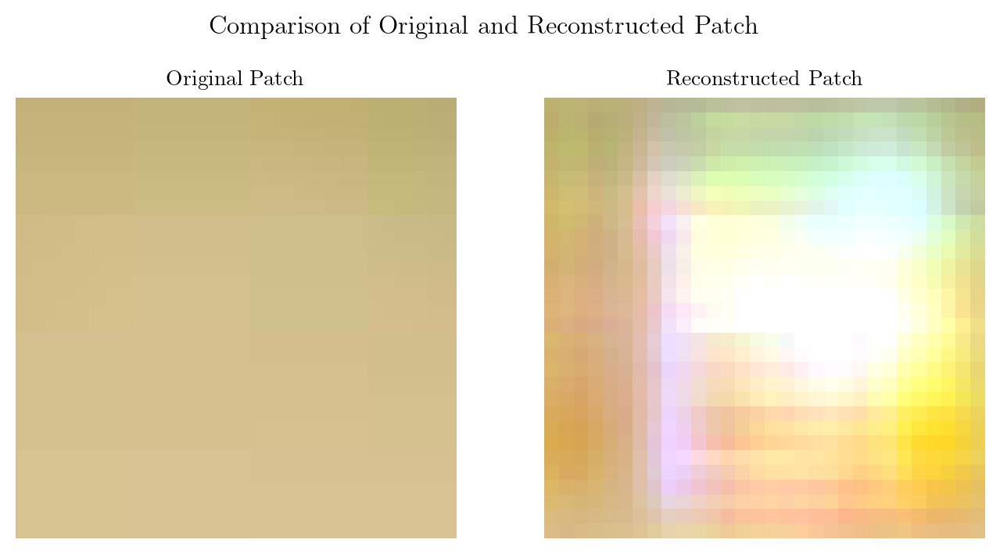

In [12]:
features = 50
train_reconstruct_plot(img_scaled, (50, 50), 30, features, 1e-6, device, allowSave = True, FileName = "./Q5DogMedia/SingleColoredPatch30")

### $(30 \times 30)$ frame with **2-3 Colors**

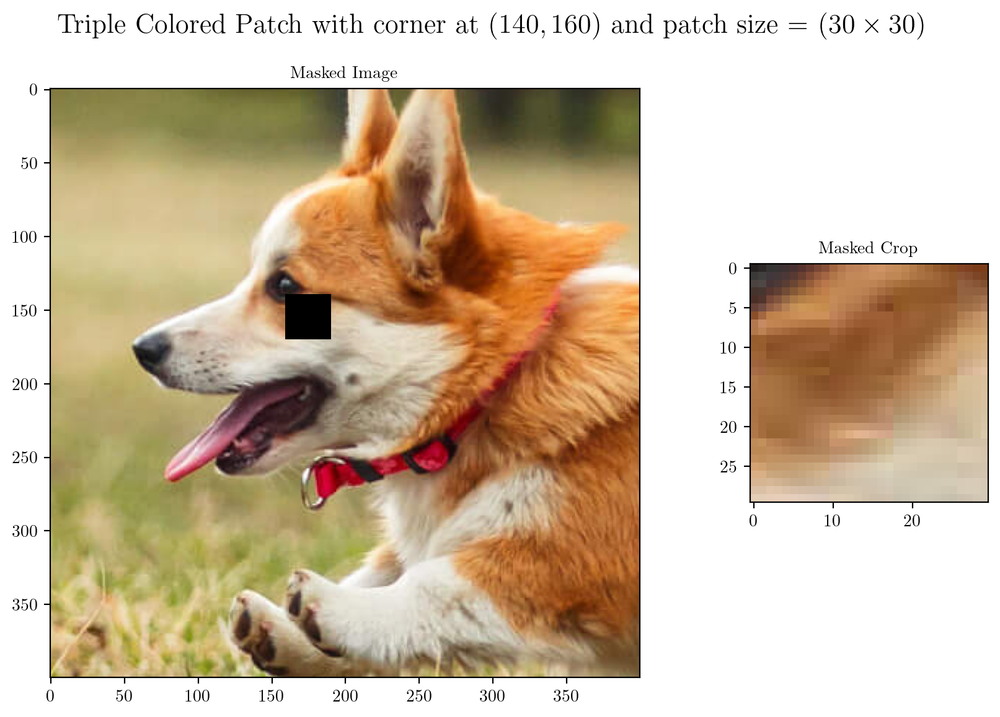

In [13]:
imgDouble30, croppedDouble30 = mask_image(img_scaled, (140, 160), 30, "Triple Colored Patch")

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


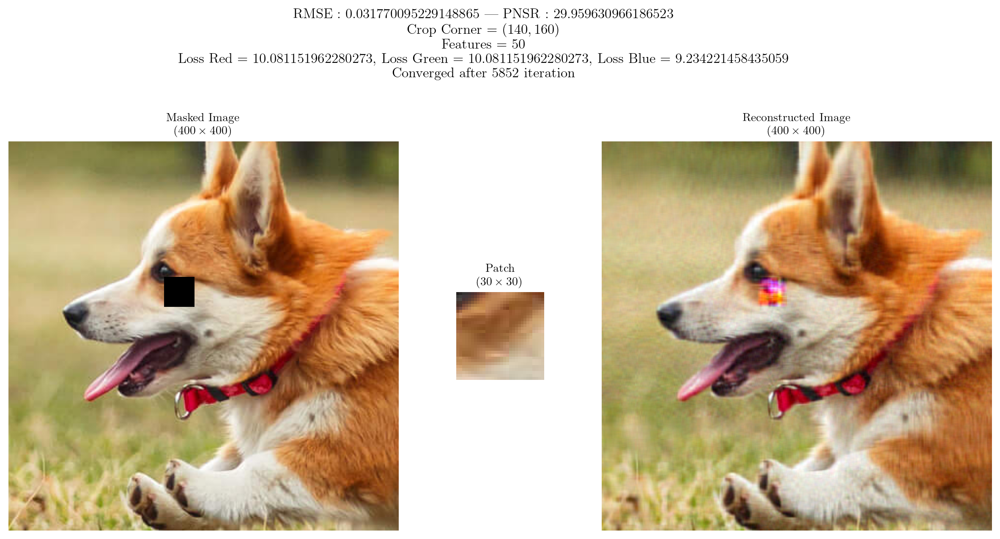

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


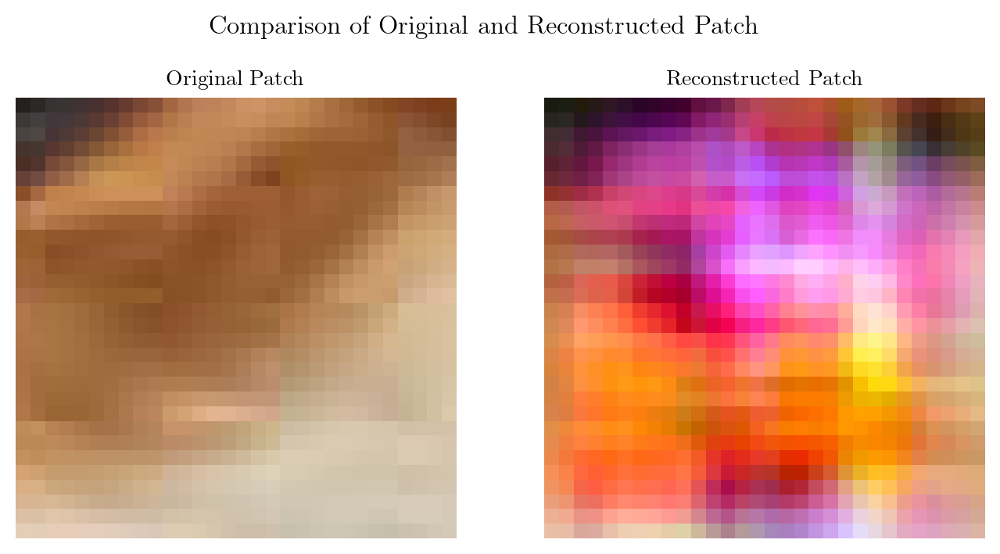

In [14]:
features = 50
train_reconstruct_plot(img_scaled, (140, 160), 30, features, 1e-6, device, allowSave = True, FileName = "./Q5DogMedia/TripleColoredPatch30")

### $(30 \times 30)$ frame with atleast **5 Colors**

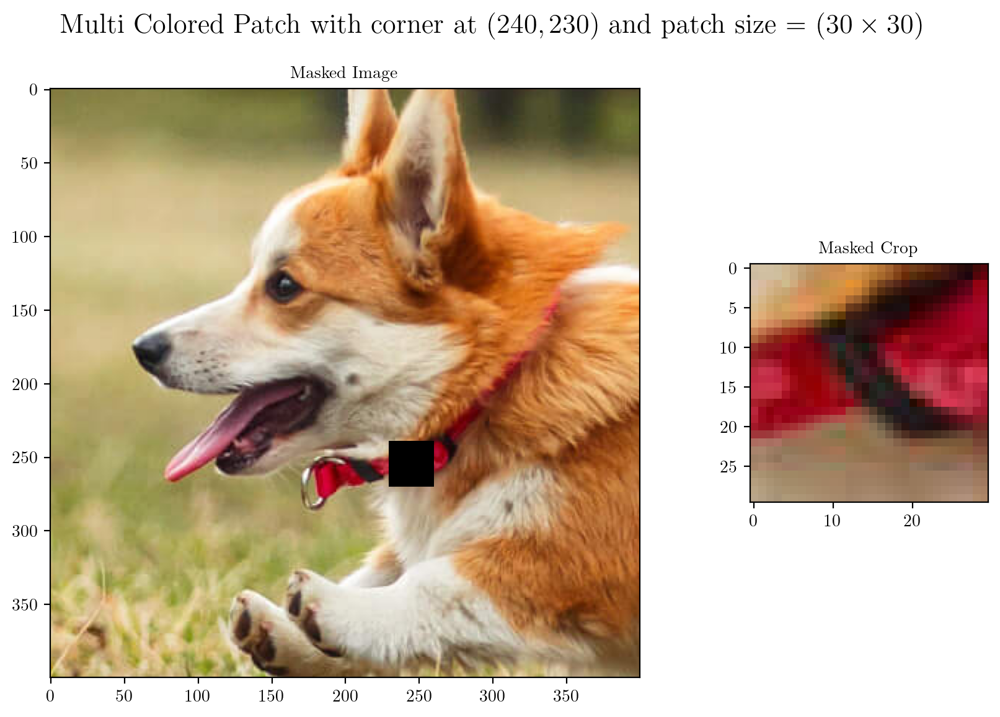

In [15]:
imgMulti30, croppedMulti30 = mask_image(img_scaled, (240, 230), 30, "Multi Colored Patch")

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


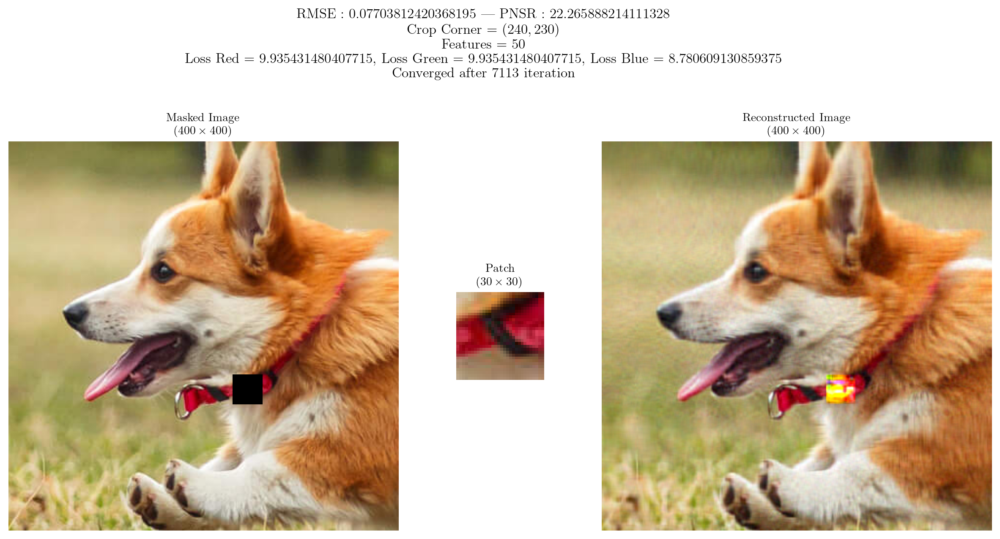

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


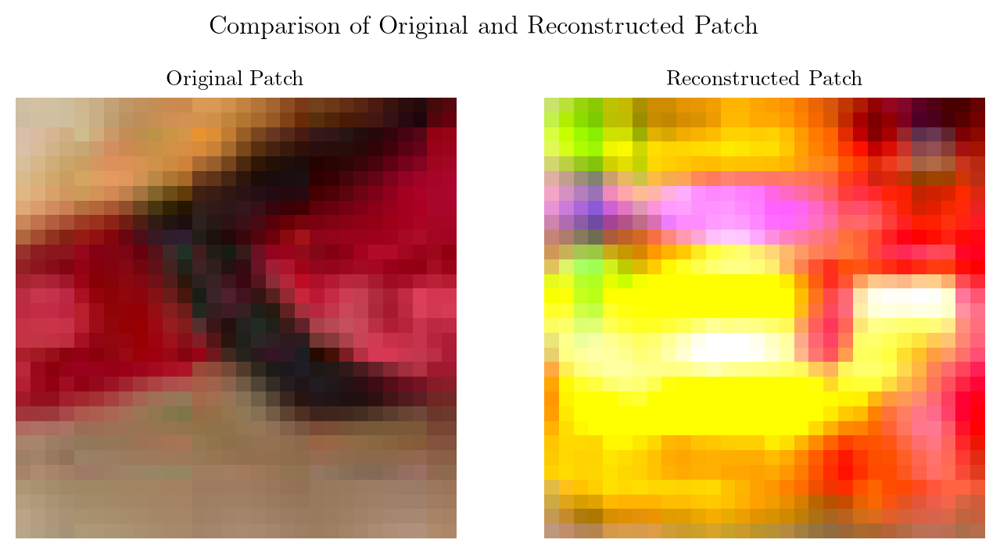

In [16]:
features = 50
train_reconstruct_plot(img_scaled, (240, 230), 30, features, 1e-6, device, allowSave = True, FileName = "./Q5DogMedia/MultiColoredPatch30")

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


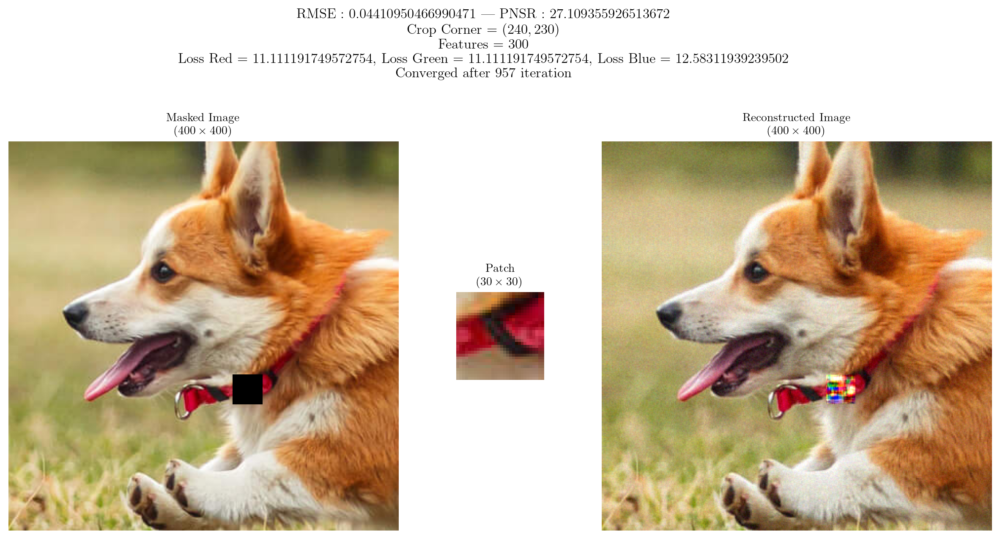

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


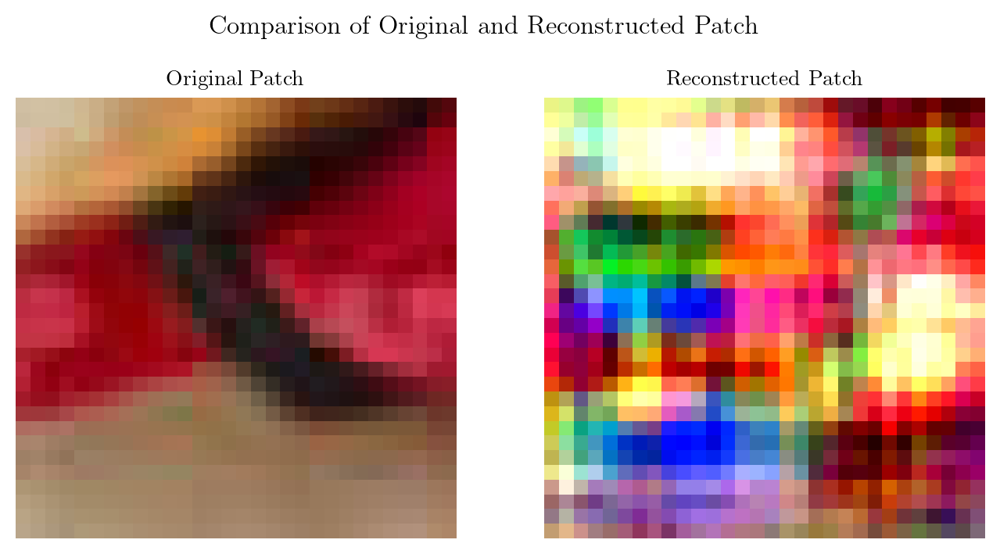

In [17]:
features = 300
train_reconstruct_plot(img_scaled, (240, 230), 30, features, 1e-6, device, allowSave = True, FileName = "./Q5DogMedia/MultiColoredPatch30_Alt")

## $ \text{Patch Size} = \set{20, 40, 60, 80, 100}$

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


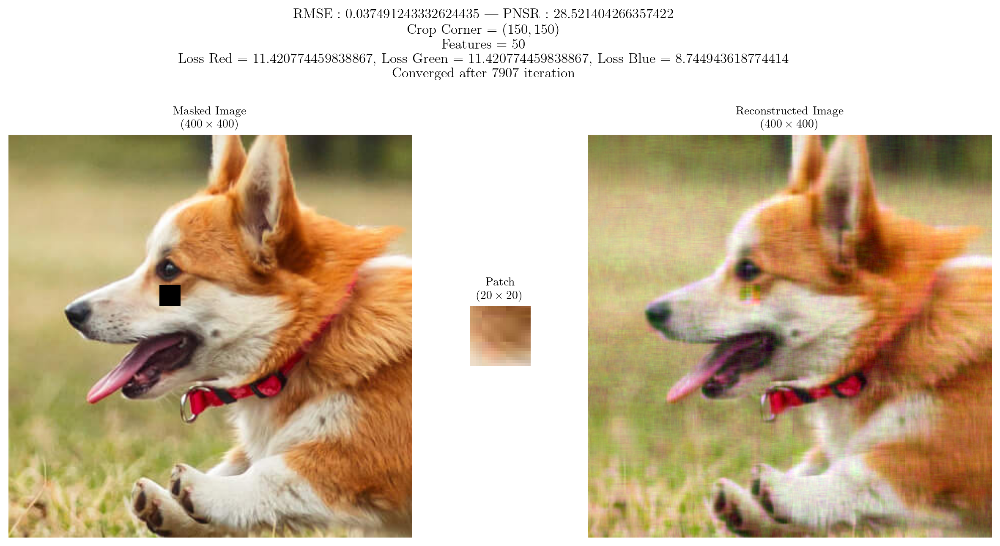

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


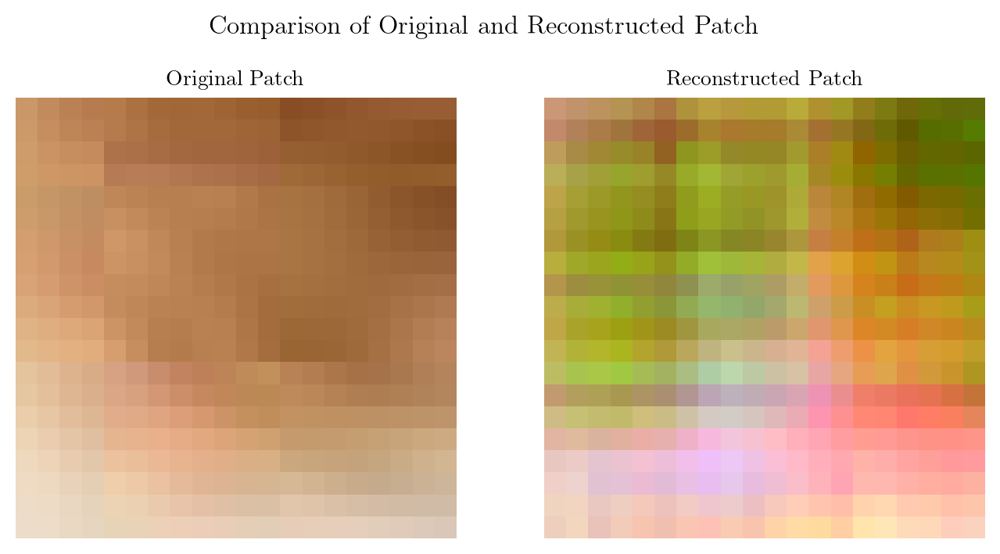

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


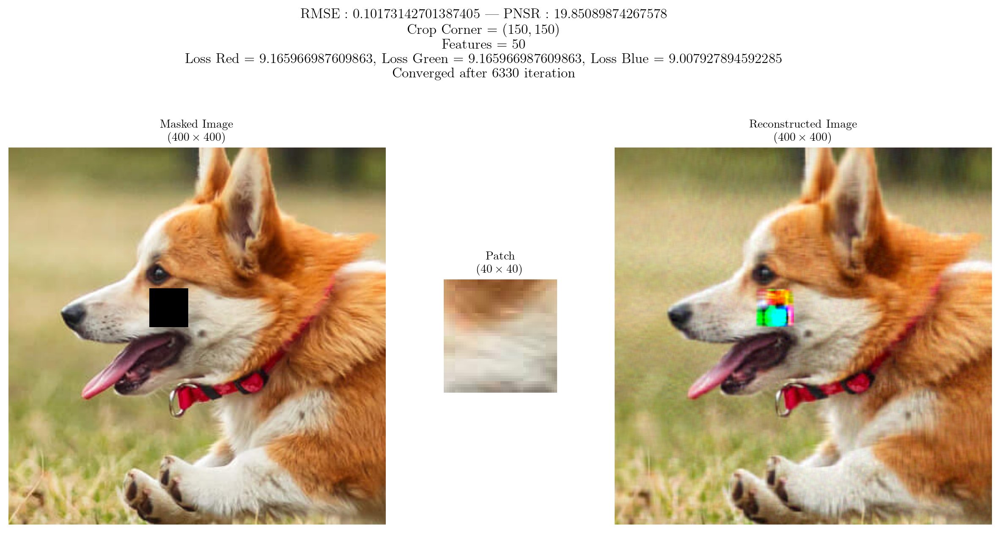

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


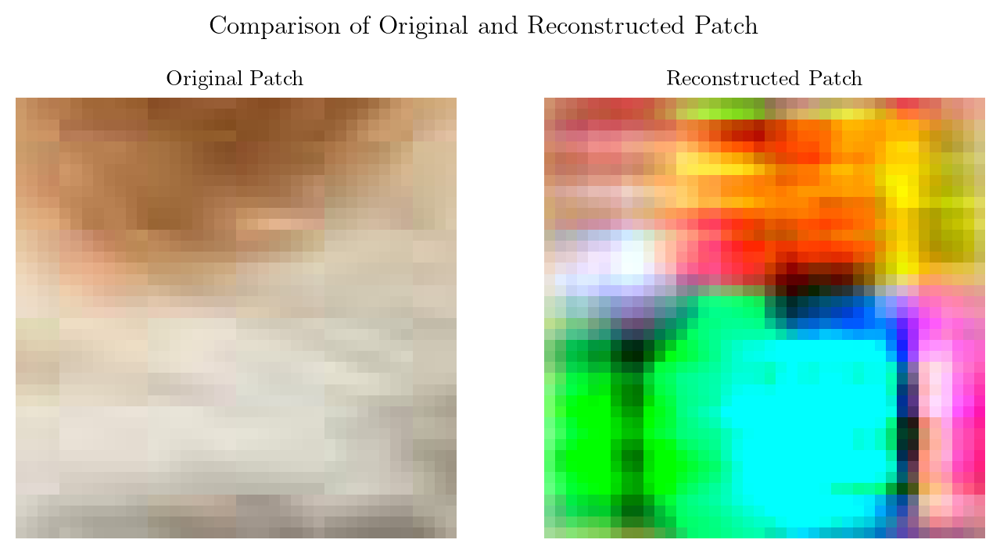

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


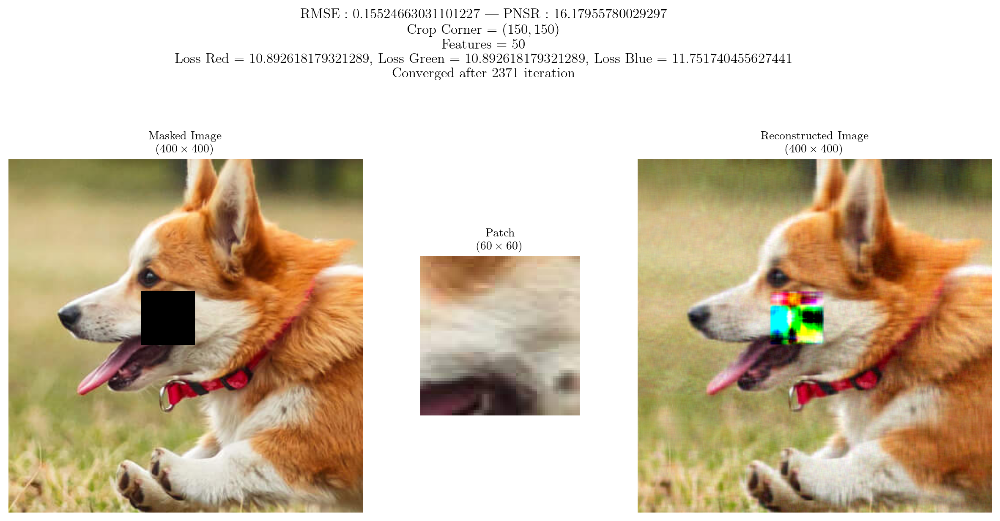

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


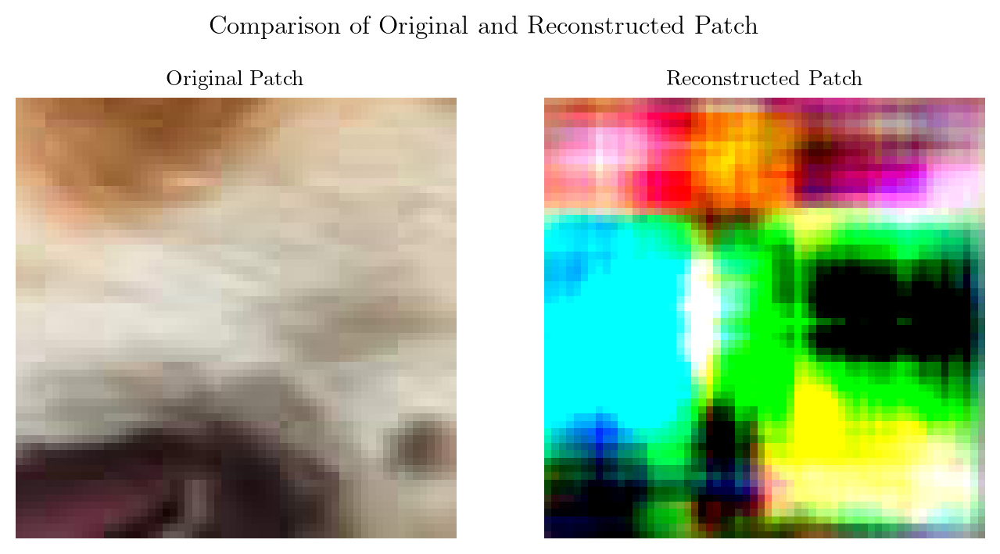

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


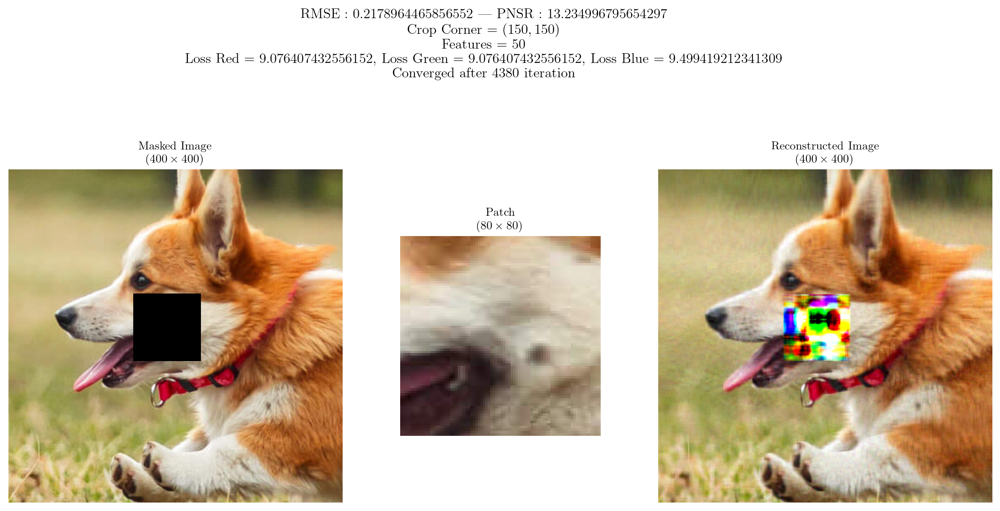

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


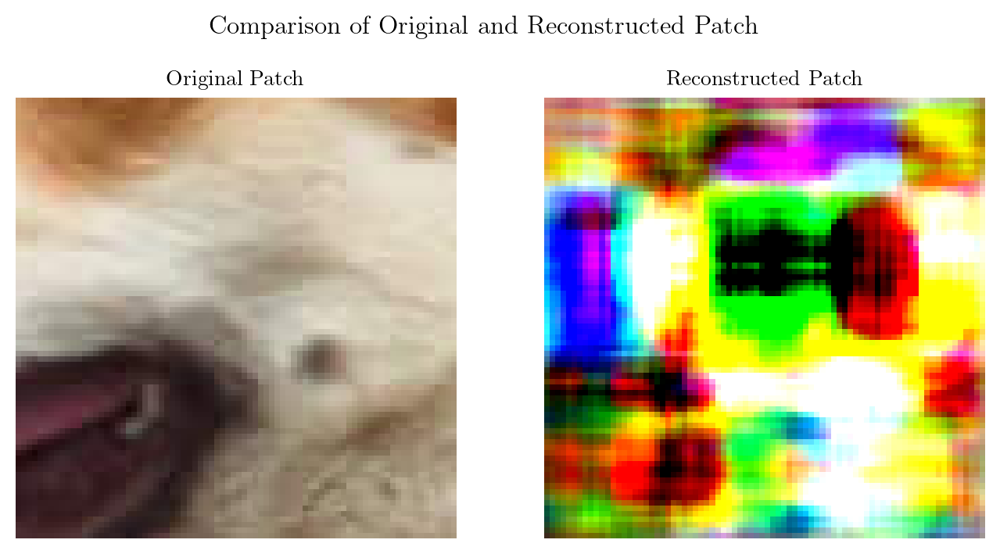

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


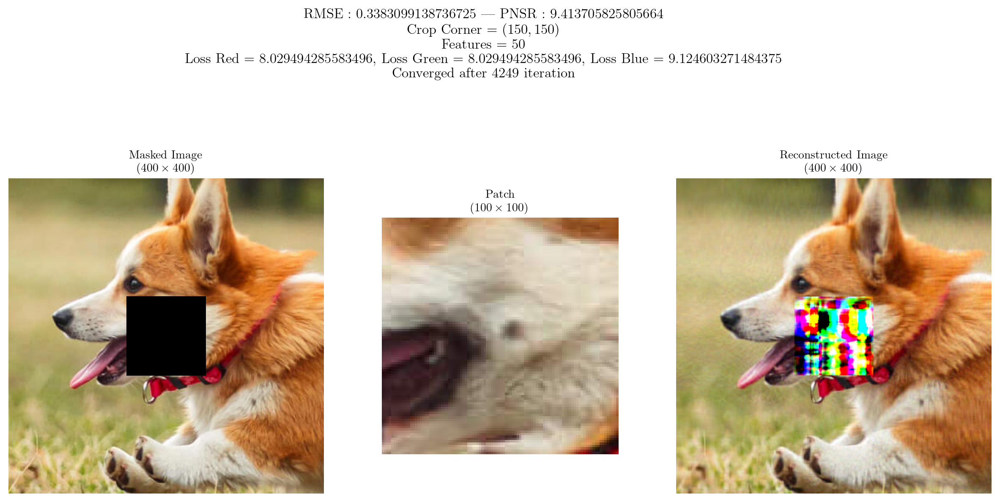

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


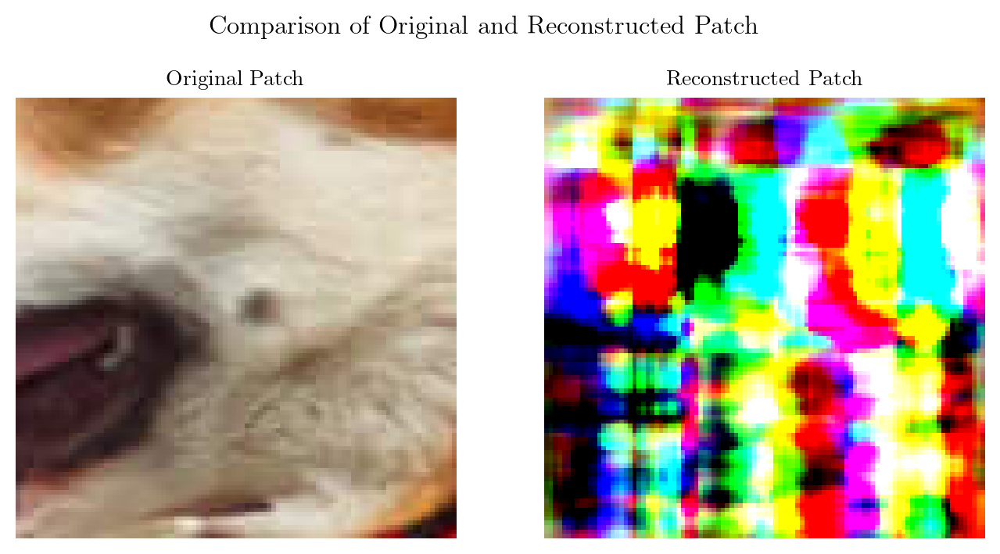

In [18]:
features = 50
rmses, psnrs = [], []
for i, patch_size in enumerate([20, 40, 60, 80, 100]):
    rmse, psnr = train_reconstruct_plot(img_scaled, (150, 150), patch_size, features, 1e-6, device, allowSave = True, FileName = f"./Q5DogMedia/Patch{patch_size}", allowMetrics = True)
    rmses.append(rmse)
    psnrs.append(psnr)

In [19]:
rm = [x.detach().cpu().numpy() for x in rmses]

## RMSE for varying Depth

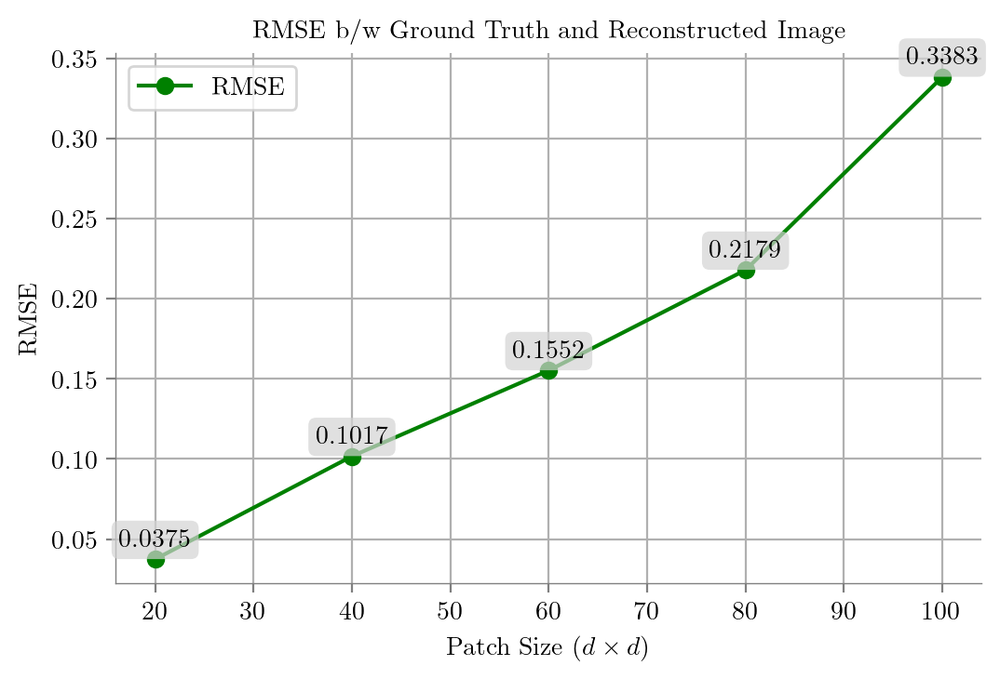

In [20]:
latexify(columns = 2, fig_width = 6)
plt.plot(range(20, 120, 20), rm, marker = "o", label = "RMSE", color = "green")
plt.xlabel(r"Patch Size $(d \times d)$")
plt.ylabel("RMSE")
plt.title("RMSE b/w Ground Truth and Reconstructed Image")
plt.grid()
plt.legend()
format_axes(plt.gca())
for i, psnr in enumerate(rm):
    plt.annotate(f'{psnr:.4f}', (range(20, 120, 20)[i], psnr), textcoords="offset points", xytext=(0, 5), ha="center",
                 bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='lightgray', alpha=0.7))
plt.show()

## PSNR for varying Depth

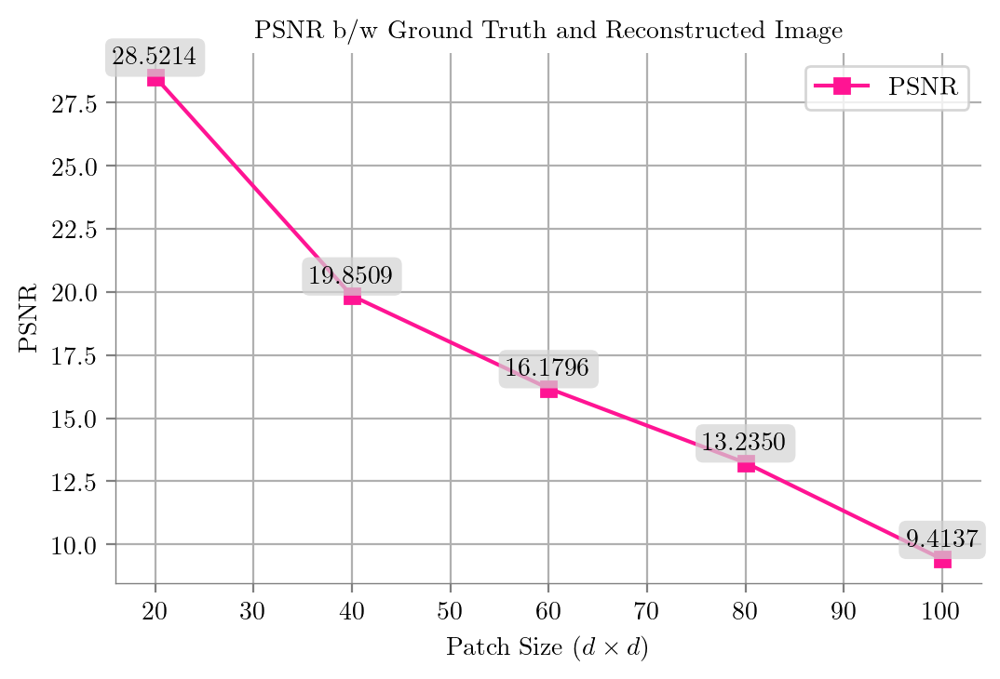

In [21]:
latexify(columns = 2, fig_width = 6)
plt.plot(range(20, 120, 20), psnrs, marker = "s", label = "PSNR", color = "deeppink")
plt.xlabel(r"Patch Size $(d \times d)$")
plt.ylabel("PSNR")
plt.title("PSNR b/w Ground Truth and Reconstructed Image")
plt.grid()
plt.legend()
format_axes(plt.gca())
for i, psnr in enumerate(psnrs):
    plt.annotate(f'{psnr:.4f}', (range(20, 120, 20)[i], psnr), textcoords="offset points", xytext=(0, 5), ha="center",
                 bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='lightgray', alpha=0.7))
plt.show()

## $\text{Features} = \set{5, 10, 50, 100}$

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


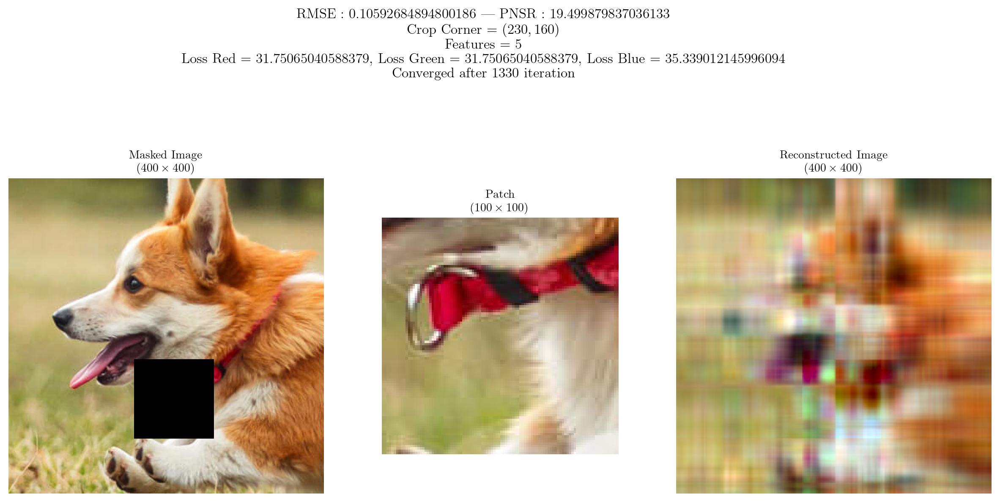

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


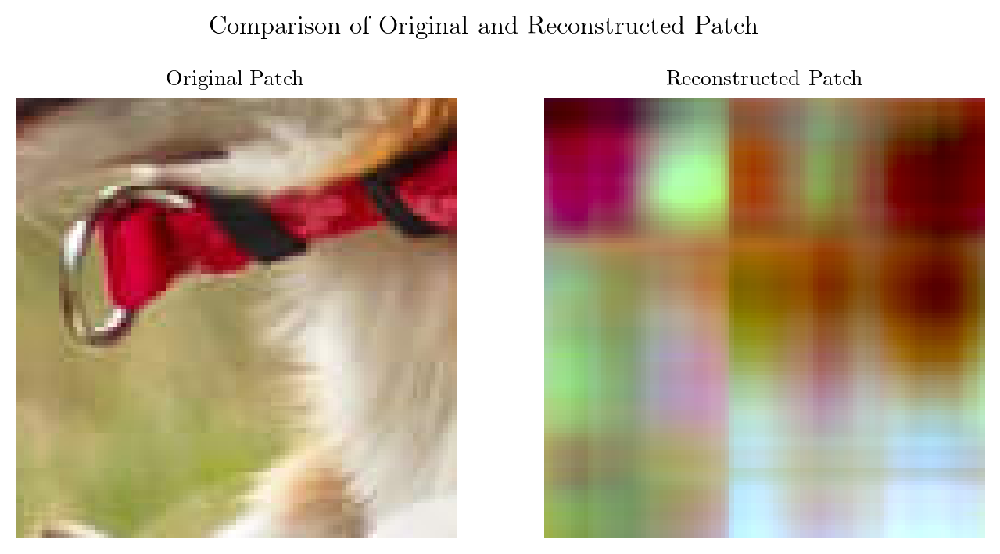

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


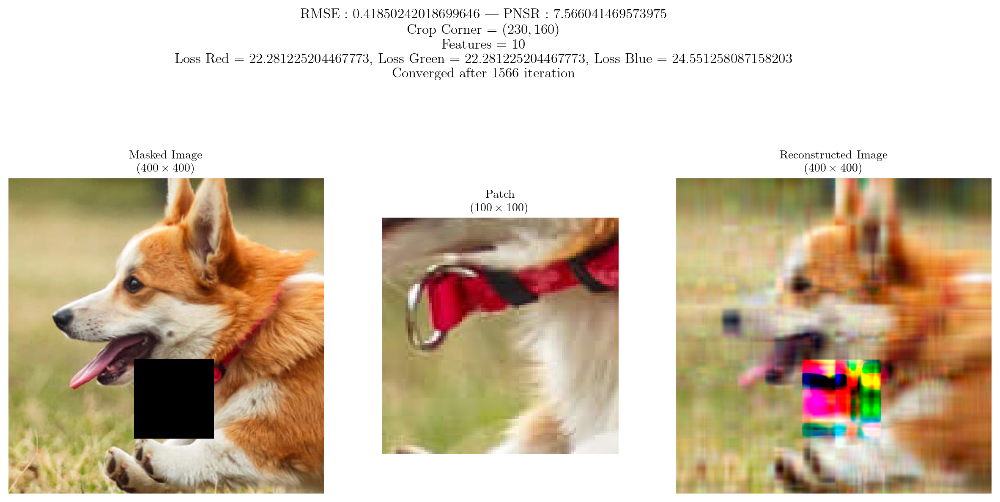

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


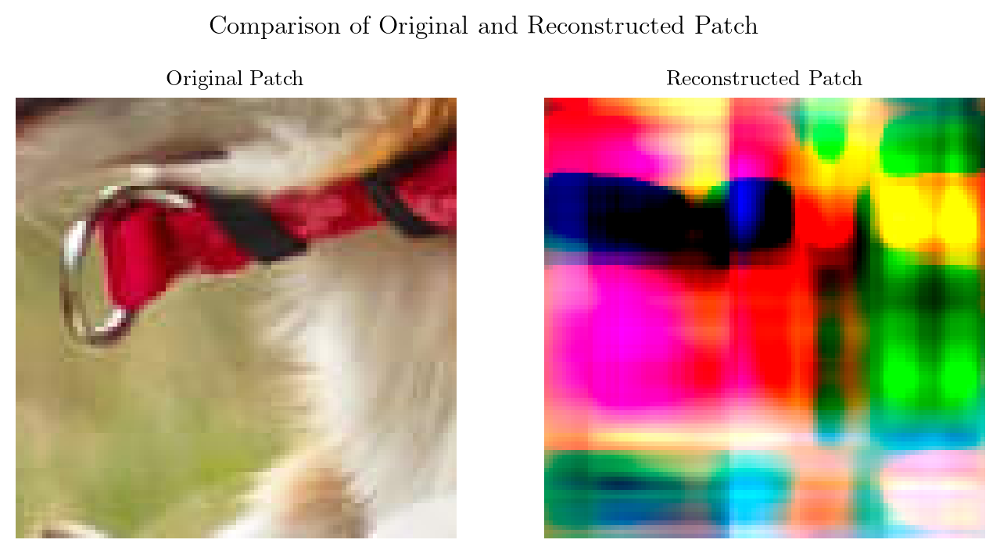

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


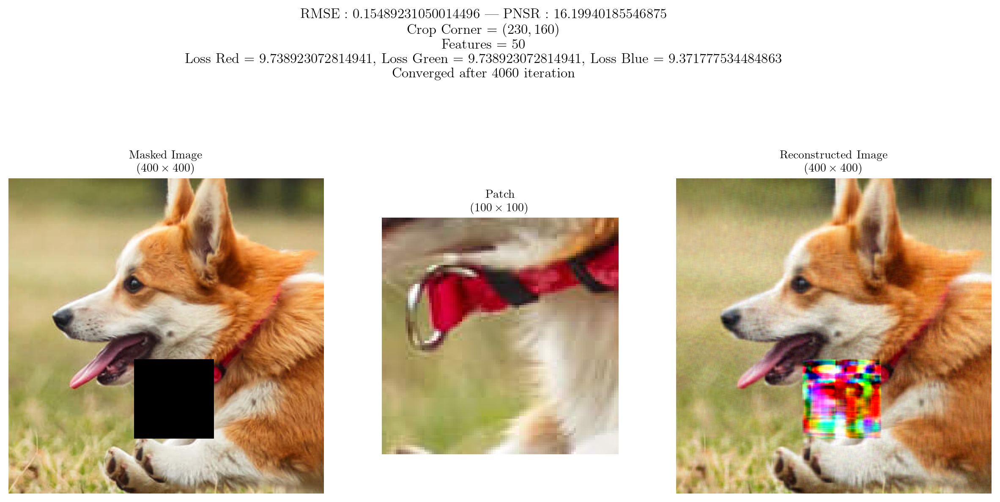

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


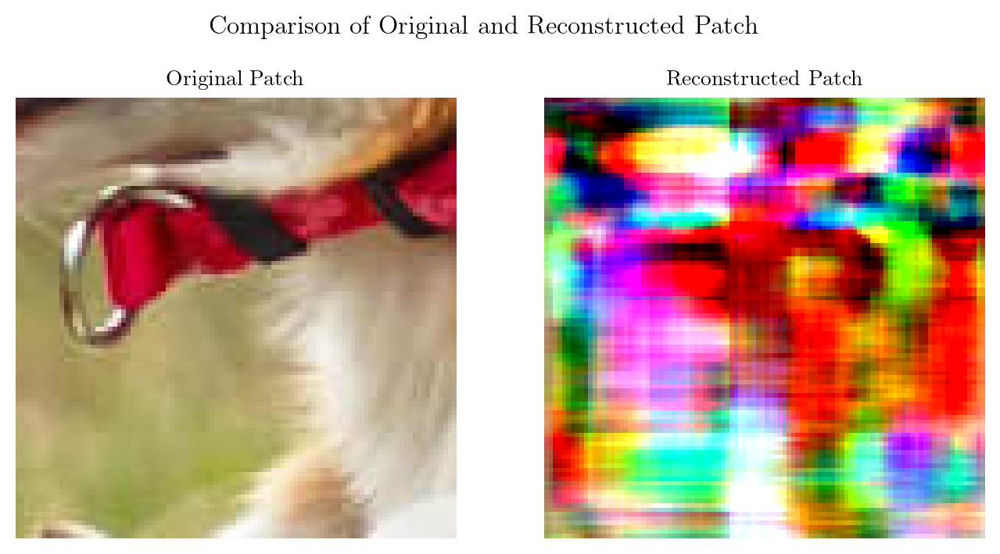

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


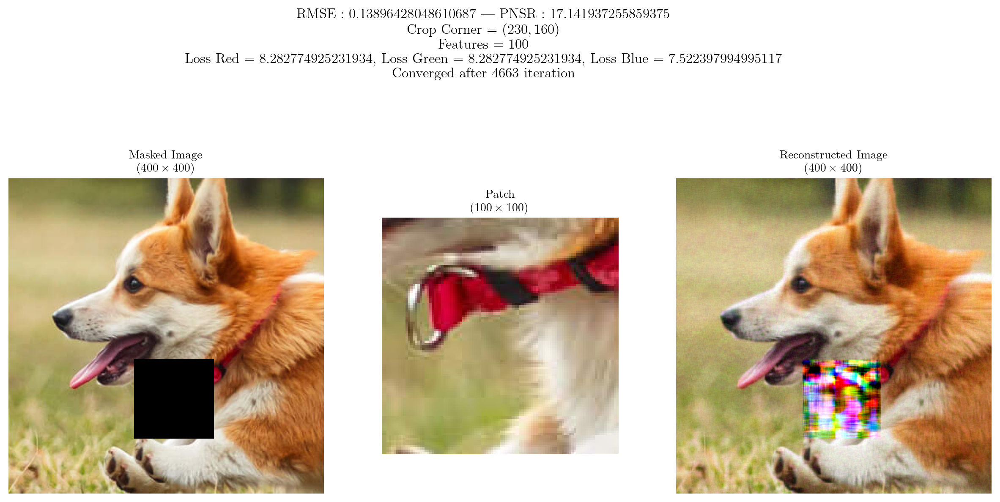

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


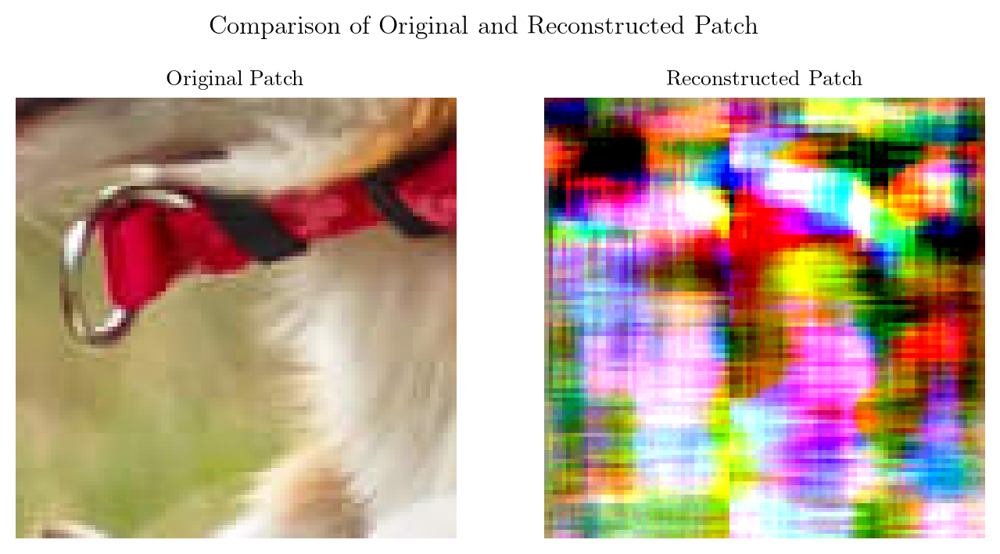

In [22]:
rmses, psnrs = [], []
for i, features in enumerate([5, 10, 50, 100]):
    rmse, psnr = train_reconstruct_plot(img_scaled, (230, 160), 100, features, 1e-6, device, allowSave = True, FileName = f"./Q5DogMedia/Feature{features}", allowMetrics = True)
    rmses.append(rmse)
    psnrs.append(psnr)

## RMSE for varying Low Rank Value

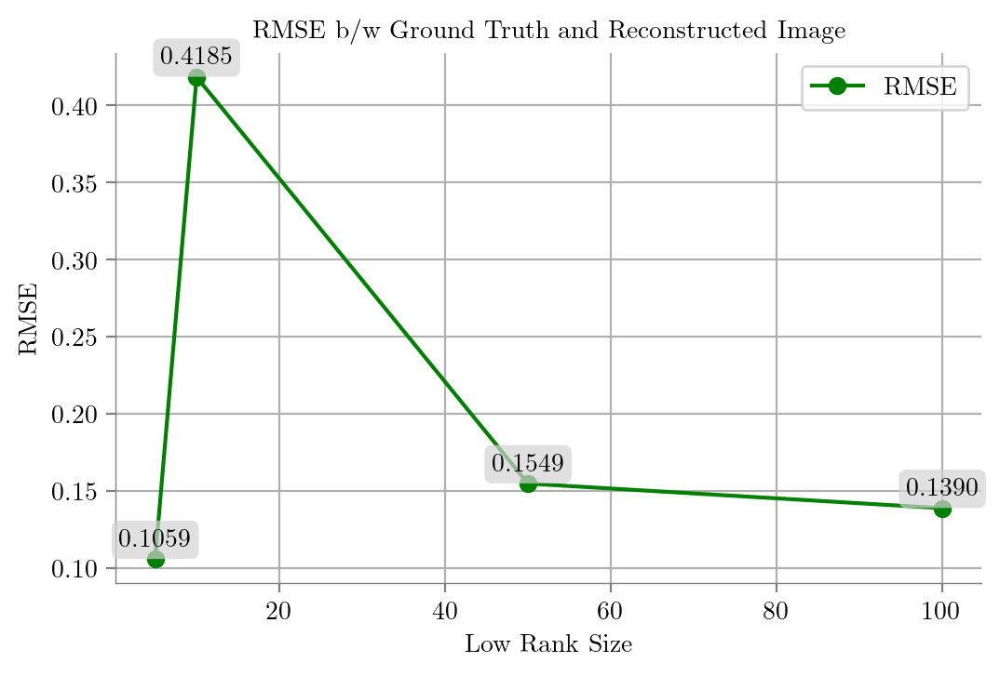

In [23]:
rm = [x.detach().cpu().numpy() for x in rmses]
latexify(columns = 2, fig_width = 6)
plt.plot([5, 10, 50, 100], rm, marker = "o", label = "RMSE", color = "green")
plt.xlabel("Low Rank Size")
plt.ylabel("RMSE")
plt.title("RMSE b/w Ground Truth and Reconstructed Image")
plt.grid()
plt.legend()
format_axes(plt.gca())
for i, psnr in enumerate(rm):
    plt.annotate(f'{psnr:.4f}', ([5, 10, 50, 100][i], psnr), textcoords="offset points", xytext=(0, 5), ha="center",
                 bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='lightgray', alpha=0.7))
plt.show()

## PSNR for varying Low Rank Value

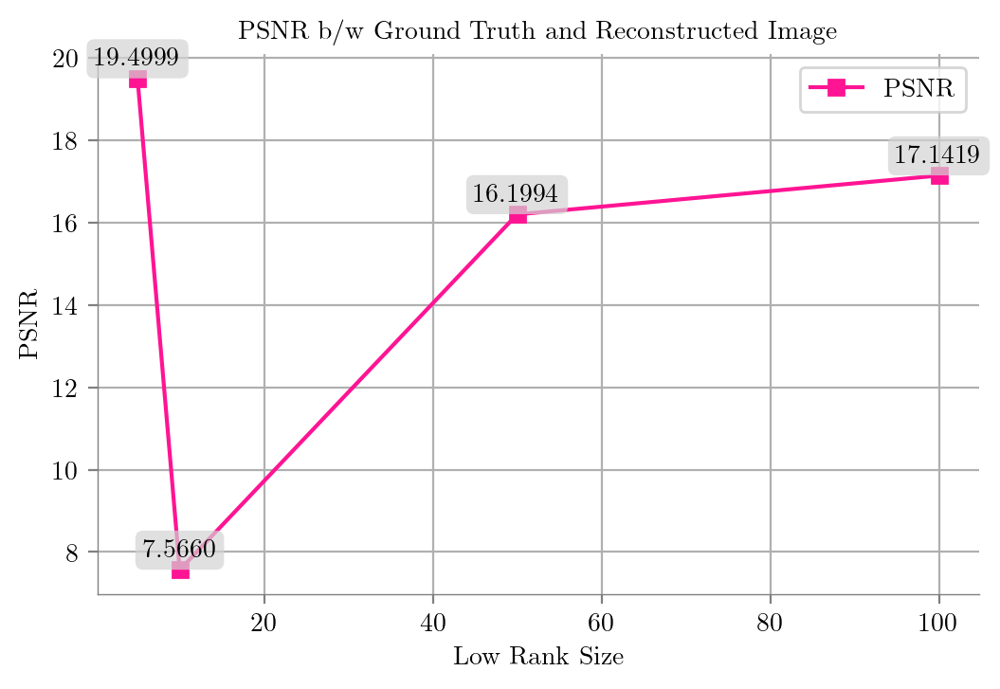

In [24]:
latexify(columns = 2, fig_width = 6)
plt.plot([5, 10, 50, 100], psnrs, marker = "s", label = "PSNR", color = "deeppink")
plt.xlabel("Low Rank Size")
plt.ylabel("PSNR")
plt.title("PSNR b/w Ground Truth and Reconstructed Image")
plt.grid()
plt.legend()
format_axes(plt.gca())
for i, psnr in enumerate(psnrs):
    plt.annotate(f'{psnr:.4f}', ([5, 10, 50, 100][i], psnr), textcoords="offset points", xytext=(0, 5), ha="center",
                 bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='lightgray', alpha=0.7))
plt.show()